In [1]:
import pandas as pd
import numpy as np
import os
from pathlib import Path
from numba import njit

In [2]:
path = Path('/Users/lfu/Alien/cart_pole/q_learning/0525_113819')
csvfiles = list(path.glob('**/ql_*.csv'))

In [3]:
file = csvfiles[0]
df = pd.read_csv(file)

In [8]:
df2 = df.iloc[:500000]

In [9]:
df2

,Unnamed: 0,reward,episodeLength,eps,lastState
0,0,-395.728857,66,1.0,"(5, 5, 1, 8, 0)"
1,1,-401.758168,15,1.0,"(5, 5, 1, 8, 0)"
2,2,-401.055737,8,1.0,"(5, 5, 1, 8, 0)"
3,3,-400.509418,35,1.0,"(5, 5, 1, 8, 0)"
4,4,-403.267501,16,1.0,"(5, 5, 1, 8, 0)"
...,...,...,...,...,...
499995,499995,852.533158,800,0.1,"(5, 5, 1, 8, 0)"
499996,499996,855.666981,800,0.1,"(5, 5, 1, 8, 0)"
499997,499997,849.941025,800,0.1,"(5, 5, 1, 8, 0)"
499998,499998,835.605761,800,0.1,"(5, 5, 1, 8, 0)"


In [10]:
df2['reward_roll'] = df2.reward.rolling(1000).mean()
df2.plot(y='reward_roll')

<ipython-input-10-19606cdbb2ee>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [22]:
import math
def get_epsilon(t, min_epsilon, decay):
    return max(min_epsilon, min(1., 1. - math.log10((t + 1) / decay)))
n=10000
decay = n/15
min_epsilon = 0.1
EPS = get_epsilon(n, min_epsilon, decay)

x = np.linspace(1, n, n)
y = np.array([get_epsilon(t, min_epsilon, decay) for t in x])

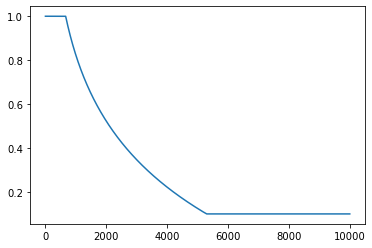

In [23]:
import matplotlib.pyplot as plt
plt.plot(x, y)

In [2]:
df = pd.read_csv('/Users/lfu/Alienware/cart_pole/q_learning/0617_102654/100000_ep.csv')
df.plot(y=['costheta', 'sintheta'])